In [20]:
from astropy.io import fits
import matplotlib.pyplot as plt
import numpy as np

In [21]:
sys.path.append('../../../satmetrics')
sys.path.append('../../../reca-streaks')

import line_detection_updated as ld
from photutils.background import Background2D

import image_rotation as ir
import streak_photometry

import pixelplot

In [18]:
root = "/home/plazas/DATA/DECam-sample-streak-images/"
fits_files = {
    (1033925, 17): root + "2f8ef733fa7c2affc9937357519e5148/contents",
    (1061946, 18): root + "f9356eeb22aa0efaedbf094f24c07f46/contents",
    (1049047, 18): root + "637aa3fb7d37a2ec076c8d945eab6c41/contents",
    (1134933, 5):  root + "1c1eebc352ea7660ff514d1b5df563b5/contents",
    (1138498, 23): root + "bb528e73d3221682c2d7d36246577ce5/contents",
    (1103448, 26): root + "c0bc6f8bf8d47c08c9bd40902ec4dad5/contents",
    (1072590, 5):  root + "5b514488fd31468a5c4aa3192c597a30/contents",
    (1161471, 9):  root + "3452b0b8f0665cd55acf1c0a0eb2e859/contents",
    (1129877, 51): root + "73234656cc02496d9a023dd0d117354a/contents",
    (1126795, 39): root + "29d9a03051904435919ec43194f969cd/contents",
    (984831, 7):   root + "90a49bfcacf8573b76b5477722e183f7/contents",
    (984831, 28):  root + "cc27b87c5865fd628e3d1aff2b57e330/contents",
    (1054799, 38): root + "a89a7ddeacf3633f83d382bfddb97ee5/contents",
    (1074544, 28): root + "426fe2b46afc5b5cea29ae864d11e73a/contents",
    (1074544, 17): root + "04dd6929bc54810daa7624bff154b15c/contents",
    (1189811, 26): root + "f0d3c52b3544829a2ff771baf77d4e00/contents",
    (1074073, 32): root + "f0a9671bb09939f1a141d87010d45101/contents",
    (1166793, 45): root + "34a0b1e227d593e1005691726b8d262b/contents",
    (1125268, 21): root + "ec65024afa8ab1486bf8e0f1fd676964/contents",
    (1125268, 14): root + "bf34a85f1c84bdaa26b0fcd378e296d3/contents",
}

In [3]:
root = "/home/plazas/DATA/starlinks_decam_2025NOV08/"

fits_files = {
    (1033925, 11): root + "e08b169e6c7cb7fe6ae31958df83d2f7/contents",
    (1033925,  6): root + "7632cc177629076385efa5b671a00efd/contents",
    (1033925, 24): root + "f9f551cc71a84502c22d120b2b51a8c0/contents",

    (1138498, 29): root + "dbcbb4b44f4d175b2ccd4cb7e82dba5a/contents",
    (1138498, 36): root + "ad9bfb83fea639efb0b47e84dde6ca05/contents",
    (1138498, 42): root + "1e6c28d5046d00200304b17d2a46b05b/contents",
    (1103448, 40): root + "1270d649a915e6d443f525295566b298/contents",
}

In [22]:
root = "/home/plazas/DATA/starlinks_decam_2025NOV08/"

fits_files = {
    (1103448, ccd): root + "1270d649a915e6d443f525295566b298/contents"
    for ccd in range(1, 63)
}

In [23]:
def detect_lines_hough(image, threshold=0.075, flux_prop_thresholds=[0.1,0.2,0.3,1], 
                       blur_kernel_sizes=[3,5,9,11], brightness_cuts=(2,2), thresholding_cut=0.5 ,**kwargs):

    """
    Applies Hough Transform line detection on a DECam image using the custom satmetrics module.

    Parameters:
        image (ndarray): 2D image array.
        **kwargs: Optional keyword arguments to pass into the LineDetection object (e.g. thresholds).
    """
    lineDetector = ld.LineDetection(image)
    lineDetector.threshold = threshold
    lineDetector.flux_prop_thresholds = flux_prop_thresholds
    lineDetector.blur_kernel_sizes = blur_kernel_sizes
    lineDetector.brightness_cuts = brightness_cuts
    lineDetector.thresholding_cut = thresholding_cut
    # Detector instance
   # lineDetector = ld.LineDetection(image)
    #lineDetector.threshold = 0.012 it could break the threshold
    for key, value in kwargs.items():
        setattr(lineDetector, key, value)

    # Hough transform
    detections = lineDetector.hough_transformation()
    return detections

In [5]:
def rotate_streak_horizontal(image, lines):
    """
    Rotates the image so that the main detected streak (line) is horizontal.
    
    """
    if lines is None or len(lines) == 0:
        raise ValueError("No lines detected to use for rotation.")
    
    line = lines[0]
    coords = [[line[0], line[1]], [line[2], line[3]]]
    angle = ir.determine_rotation_angle(coords)
    rotated_image = ir.rotate_image(image, angle, coords)
    
    return rotated_image, coords, angle

/tmp/ipykernel_4209/1589169094.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


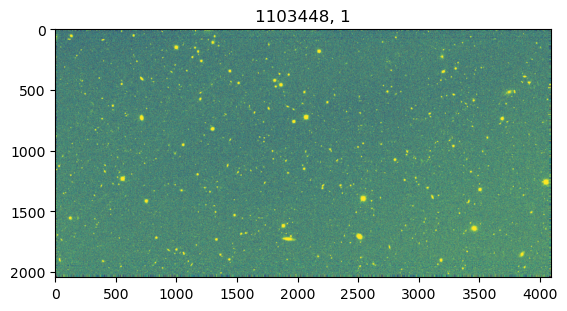

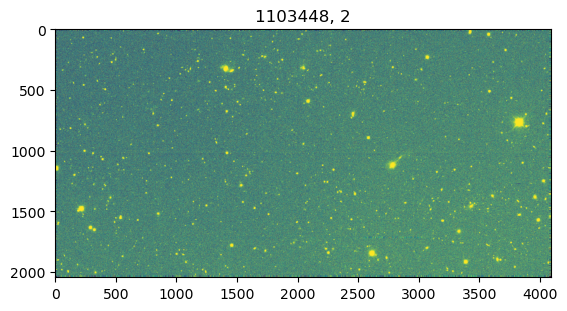

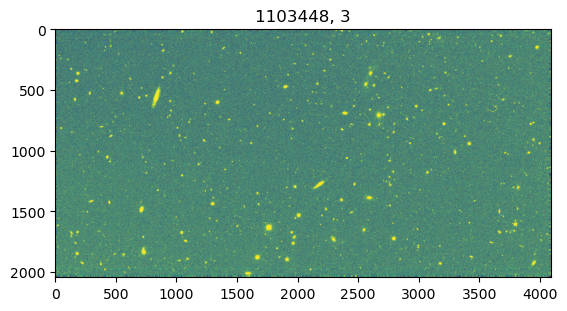

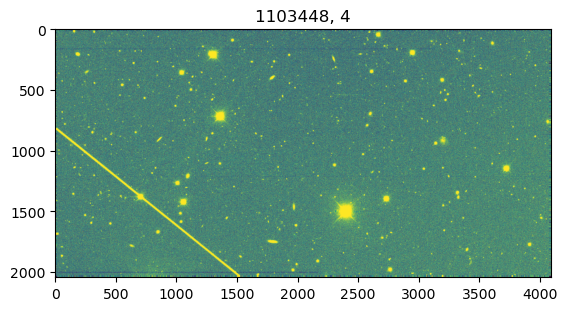

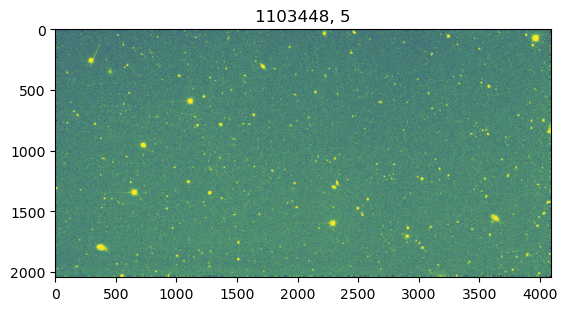

...

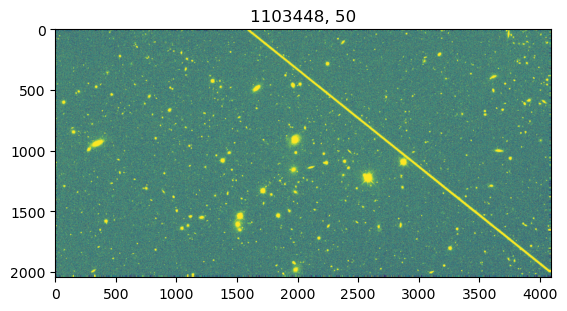

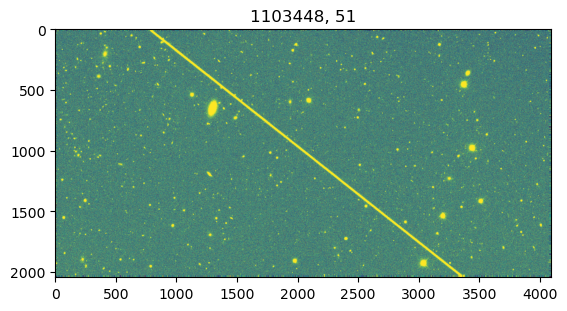

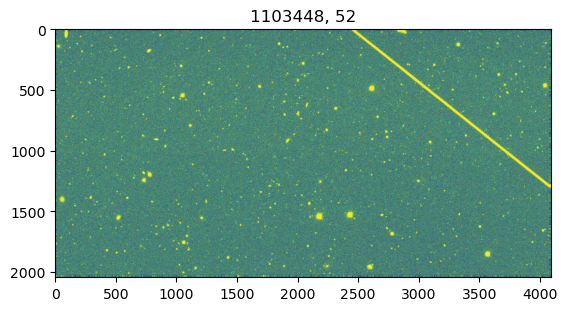

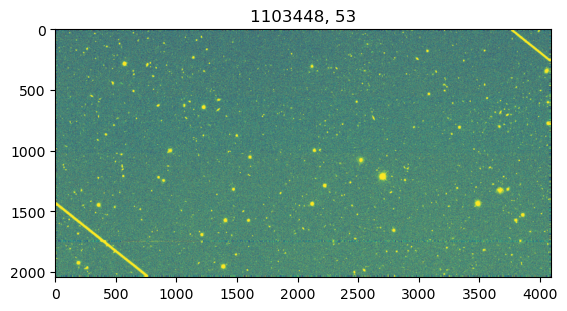

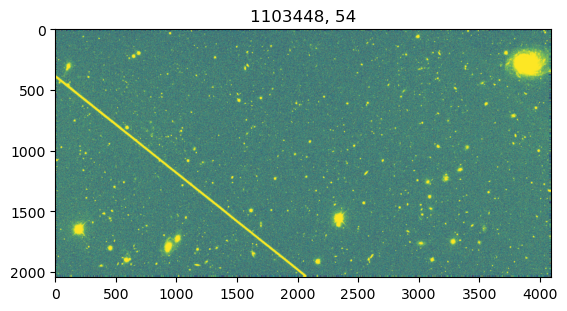

In [ ]:
#for key in fits_files:
file_name = root + "1270d649a915e6d443f525295566b298/contents"
hdulist = fits.open(file_name)
expnum = 1103448
for detector in range(1, 62):
    #expnum, detector = key
    file_name = fits_files[key]
    #hdulist = fits.open(file_name)
    image_data = hdulist[detector].data
    fig = plt.figure()
    plt.imshow(image_data.T, vmin = np.percentile(image_data,5),
          vmax = np.percentile(image_data, 95))
    plt.title(f"{expnum}, {detector}")

In [11]:
hdulist.info()

Filename: /home/plazas/DATA/starlinks_decam_2025NOV08/1270d649a915e6d443f525295566b298/contents
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     189   ()      
  1  S29           1 CompImageHDU    113   (2046, 4094)   float32   
  2  S30           1 CompImageHDU    113   (2046, 4094)   float32   
  3  S31           1 CompImageHDU    113   (2046, 4094)   float32   
  4  S25           1 CompImageHDU    113   (2046, 4094)   float32   
  5  S26           1 CompImageHDU    113   (2046, 4094)   float32   
  6  S27           1 CompImageHDU    113   (2046, 4094)   float32   
  7  S28           1 CompImageHDU    113   (2046, 4094)   float32   
  8  S20           1 CompImageHDU    113   (2046, 4094)   float32   
  9  S21           1 CompImageHDU    113   (2046, 4094)   float32   
 10  S22           1 CompImageHDU    113   (2046, 4094)   float32   
 11  S23           1 CompImageHDU    113   (2046, 4094)   float32   
 12  S24           1 CompImageHD

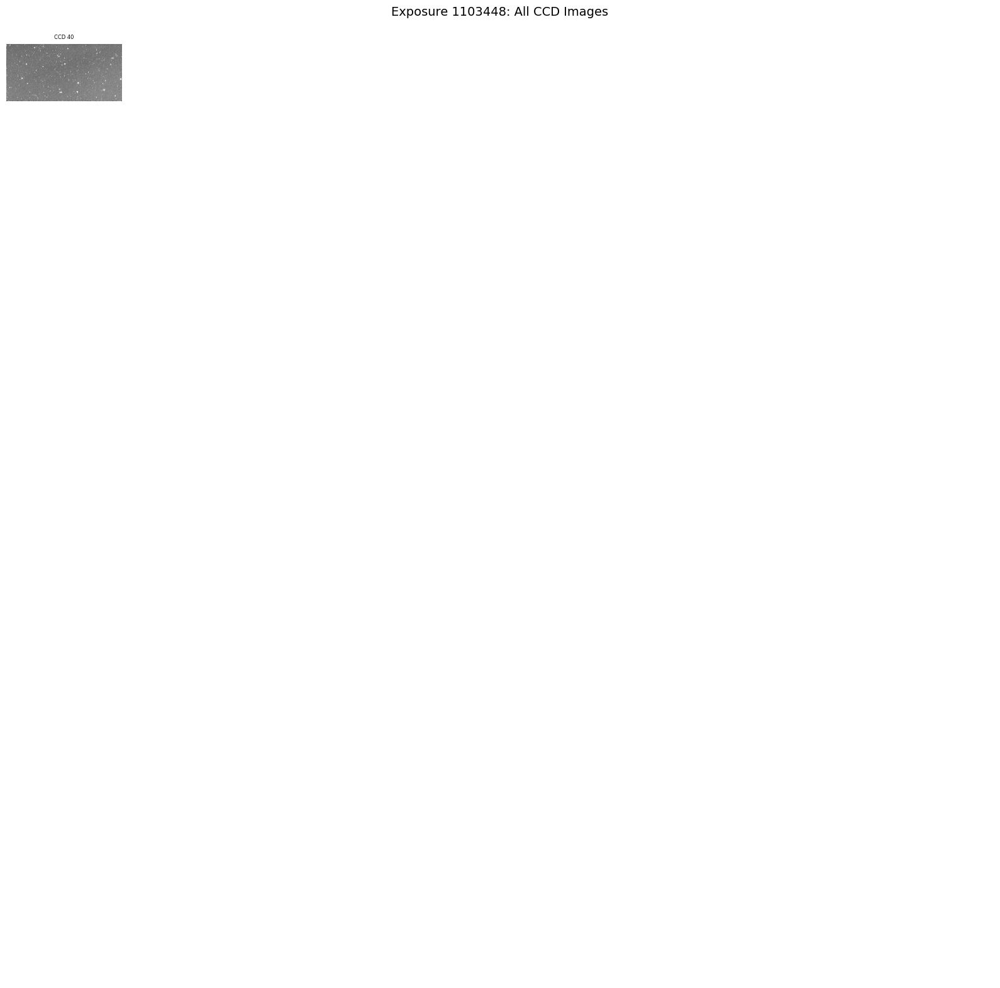

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits

exp_to_plot = 1103448          # choose exposure
grid_size = (8, 8)             # 64 panels for DECam’s 62 CCDs
n_rows, n_cols = grid_size

# Filter all detectors for this exposure
detector_keys = sorted([k for k in fits_files if k[0] == exp_to_plot],
                       key=lambda x: x[1])

fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 16))
axes = axes.flatten()

# Loop through detectors and fill the grid
for ax, key in zip(axes, detector_keys):
    expnum, detector = key
    file_name = fits_files[key]

    try:
        with fits.open(file_name) as hdul:
            img = hdul[1].data
    except Exception as e:
        ax.set_title(f"{detector}\nERR")
        ax.axis("off")
        continue

    vmin = np.percentile(img, 5)
    vmax = np.percentile(img, 95)

    ax.imshow(img.T, vmin=vmin, vmax=vmax, cmap="gray")
    ax.set_title(f"CCD {detector}", fontsize=6)
    ax.axis("off")

# Turn off empty panels (if fewer CCDs than grid cells)
for ax in axes[len(detector_keys):]:
    ax.axis("off")

plt.suptitle(f"Exposure {exp_to_plot}: All CCD Images", fontsize=14)
plt.tight_layout()
plt.show()

Saved: streak_mosaic_table.pdf


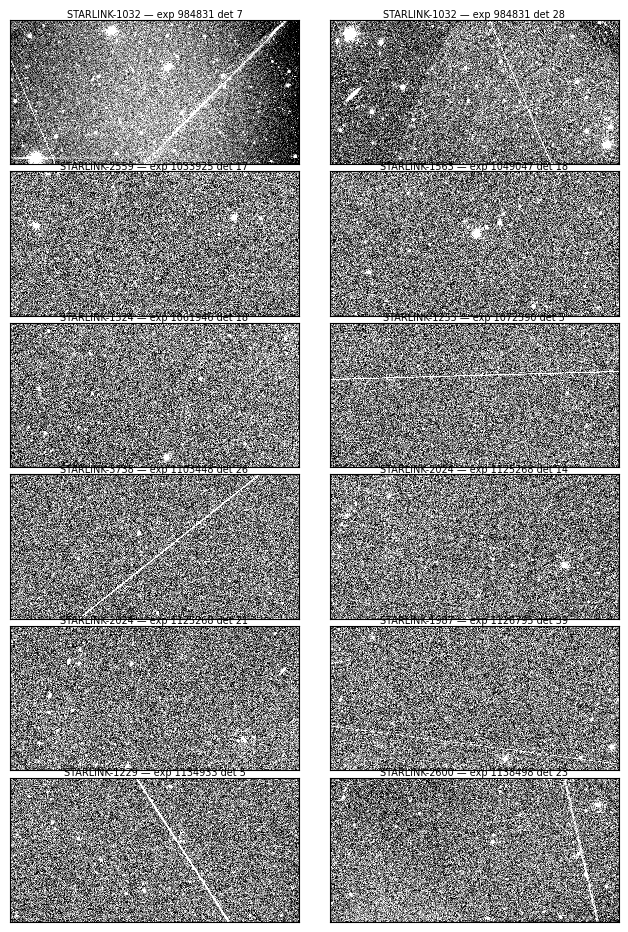

In [50]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.io import fits

# === Only the satellites included in your LaTeX table ===
starlink_name = {
    1134933: "STARLINK-1229",
    1138498: "STARLINK-2600",
    1072590: "STARLINK-1255",
    1126795: "STARLINK-1987",
    984831:  "STARLINK-1032",
    1125268: "STARLINK-2024",
    1103448: "STARLINK-3738",
    1033925: "STARLINK-2559",
    1061946: "STARLINK-1324",
    1049047: "STARLINK-1563",
}

# Build list of available keys from the table entries
keys = [(exp, det) for (exp, det) in fits_files.keys() if exp in starlink_name]

# Sort by exposure number (for consistent order)
keys = sorted(keys, key=lambda k: (k[0], k[1]))

# Compute grid dimensions automatically (2 columns)
ncols = 2
nrows = int(np.ceil(len(keys) / ncols))

fig, axes = plt.subplots(
    nrows, ncols,
    figsize=(6.5, 1.6 * nrows),
    constrained_layout=False
)
fig.subplots_adjust(left=0.02, right=0.98, top=0.97, bottom=0.03,
                    hspace=0.05, wspace=0.05)

# Flatten axes for simpler iteration
axes = np.atleast_1d(axes).flatten()

for i, ax in enumerate(axes):
    if i >= len(keys):
        ax.axis("off")
        continue

    expnum, det = keys[i]
    fname = fits_files[(expnum, det)]
    with fits.open(fname, memmap=True) as hdul:
        img = hdul[1].data

    vmin, vmax = np.percentile(img, (5, 95))
    ax.imshow(img.T, cmap="gray", origin="lower",
              vmin=vmin, vmax=vmax, interpolation="none", aspect="equal")
    ax.set_xticks([])
    ax.set_yticks([])

    name = starlink_name.get(expnum, f"exp {expnum}")
    ax.set_title(f"{name} — exp {expnum} det {det}",
                 fontsize=7, pad=1.5)

# Save compact PDF
pdf_out = "streak_mosaic_table.pdf"
fig.savefig(pdf_out, bbox_inches="tight")
print(f"Saved: {pdf_out}")

# Display inline in the notebook
plt.show()


In [23]:
detect_lines_thresholds = { (1103448, 26, 'thresholding_cut'): 0.03,
                            (1033925, 17, 'brightness_cuts'): (3,5),
                            (1033925, 17, 'thresholding_cut'): 0.08, 
                            (1061946, 18, 'thresholding_cut'): 0.08,
                            (1061946, 18, 'brightness_cuts'): (3,5),
                            (1049047, 18, 'brightness_cuts'): (3,5),
                            (1049047, 18, 'thresholding_cut'): 0.06,
                          }



In [48]:
for key in fits_files:
    print (" ")
    print (" ")
    print (" ")
    print (" ")
    expnum, detector = key
    if expnum != 1054799:
        continue
    file_name = fits_files[key]
    hdulist = fits.open(file_name)
    image_data = hdulist[1].data
    #try:
    print ("Trying: ", expnum, detector)
    detected_lines = detect_lines_hough(image_data,
                                        brightness_cuts= (3,5),
                                        thresholding_cut= 0.06)
    clustered_lines = ld.cluster(detected_lines["Cartesian Coordinates"],
                                     detected_lines["Lines"])
    rotated_images, best_fit_params = ir.complete_rotate_image(
                                                clustered_lines=clustered_lines,
                                                angles=detected_lines["Angles"],
                                                image=image_data,
                                                cart_coord=detected_lines['Cartesian Coordinates'])
    pixelplot.pixelplot(rotated_images[0])
    streak_photometry.streak_photometry(rotated_images[0], hdu_list = hdulist)
    streak_photometry.streak_photometry_psf_fitting(rotated_images[0],
                                                        hdu_list = hdulist)
    #except: 
    #    print ("       Failed: ", expnum, detector)

 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
Trying:  1054799 38


IndexError: list index out of range

In [28]:
def call_photo(det):
    try:
        hdulist = fits.open(file_name)
        image_data = hdulist[det].data
            #try:
        print ("Trying: ", expnum, det)
        detected_lines = detect_lines_hough(image_data,
                                                brightness_cuts= (3,5),
                                                thresholding_cut= 0.08)
        clustered_lines = ld.cluster(detected_lines["Cartesian Coordinates"],
                                             detected_lines["Lines"])
        rotated_images, best_fit_params = ir.complete_rotate_image(
                                                        clustered_lines=clustered_lines,
                                                        angles=detected_lines["Angles"],
                                                        image=image_data,
                                                        cart_coord=detected_lines['Cartesian Coordinates'])
        pixelplot.pixelplot(rotated_images[0])
        streak_photometry.streak_photometry(rotated_images[0], hdu_list = hdulist)
        streak_photometry.streak_photometry_psf_fitting(rotated_images[0],
                                                                hdu_list = hdulist)
    except:
        pass

Trying:  1103448 4
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 10598912.98
Noise background variance: 6770489875.90 e⁻²
Flux error: 23954.33 ADU
SNR: 128.8

=== Aperture Photometry Result ===
Streak center (y0): 48.21 px
Width: σ = 3.89 px, FWHM ≈ 9.16 px
Streak flux: 3085569.65 ADU ± 23954.33
Surface brightness: 2464.70 ± 19.13 counts/arcsec² [background-dominated]
SNR: 128.81
Photometric zeropoint not available in image header, reporting instrumental flux only.
Average amp gain (e/ADU) 3.43499391856203
Average read noise (e) 6.060411
No MAGZERO keyword in header
Hola


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Trying:  1103448 8
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 57916.01
Noise background variance: 60107874.30 e⁻²
Flux error: 2257.04 ADU
SNR: 7.5

=== Aperture Photometry Result ===
Streak center (y0): 25.83 px
Width: σ = 3.86 px, FWHM ≈ 9.08 px
Streak flux: 16860.59 ADU ± 2257.04
Surface brightness: 13.07 ± 1.75 counts/arcsec² [background-dominated]
SNR: 7.47
Photometric zeropoint not available in image header, reporting instrumental flux only.
Average amp gain (e/ADU) 3.43499391856203
Average read noise (e) 6.060411
No MAGZERO keyword in header
Hola


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  1991.197215592836
width 17.188476293796665
Npix 34225

=== Trail Fit Results (θ free) ===
Background: 266.94 counts/pixel
Total flux (phi): 31347.76 ± 200.03 ADU
Trail length (L): 1956.82 px
PSF sigma: 5.73 px → FWHM = 13.49 px --> 3.55 arcsec 
Trail angle θ: 0.60 deg
Center: x0 = 1097.48, y0 = 29.51
Surface brightness: 17.11 ± 0.11 counts/arcsec²
S/N (section 3): 10.5
Chi²: 45342.42
Reduced Chi²: 1.3680
Image with no zero point, can't convert to magnitude
Trying:  1103448 9
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: source-dominated
Flux (e⁻): 12789701.46
Noise background variance: 31253980.01 e⁻²
Flux error: 1932.04 ADU
SNR: 1927.2

=== Aperture Photometry Result ===
Streak center (y0): 49.20 px
Width: σ = 3.69 px, FWHM ≈ 8.69 px
Streak flux: 3723354.91 ADU ± 1932.04
Surface brightness: 3017.53 ± 1.57 counts/arcsec² [source-dominated]
SNR: 1927.16
Photometric zeropoint not available in image header, reporting instrumental fl

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  2103.7408161727267
width 10.052188426553071
Npix 21147

=== Trail Fit Results (θ free) ===
Background: 266.93 counts/pixel
Total flux (phi): 3812376.02 ± 146.22 ADU
Trail length (L): 2083.64 px
PSF sigma: 3.35 px → FWHM = 7.89 px --> 2.08 arcsec 
Trail angle θ: -0.14 deg
Center: x0 = 1024.71, y0 = 49.15
Surface brightness: 3342.04 ± 0.13 counts/arcsec²
S/N (section 3): 1250.5
Chi²: 24152.52
Reduced Chi²: 1.1765
Image with no zero point, can't convert to magnitude
Trying:  1103448 13
Trying:  1103448 14
Trying:  1103448 15
Trying:  1103448 19
Trying:  1103448 20
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 16115395.01
Noise background variance: 2975608000.11 e⁻²
Flux error: 15880.42 ADU
SNR: 295.4

=== Aperture Photometry Result ===
Streak center (y0): 47.45 px
Width: σ = 4.18 px, FWHM ≈ 9.86 px
Streak flux: 4691535.24 ADU ± 15880.42
Surface brightness: 3353.62 ± 11.35 counts/arcsec² [background-do

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  1928.30872191106
width 12.801908908397525
Npix 24686

=== Trail Fit Results (θ free) ===
Background: 243.13 counts/pixel
Total flux (phi): 5723048.75 ± 1334269.71 ADU
Trail length (L): 1902.70 px
PSF sigma: 4.27 px → FWHM = 10.05 px --> 2.65 arcsec 
Trail angle θ: 0.19 deg
Center: x0 = 943.73, y0 = 47.50
Surface brightness: 4314.00 ± 1005.76 counts/arcsec²
S/N (section 3): 1676.5
Chi²: 183408.52
Reduced Chi²: 7.5220
Image with no zero point, can't convert to magnitude
Trying:  1103448 21
Trying:  1103448 22
Trying:  1103448 25
Trying:  1103448 26
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 15678412.99
Noise background variance: 270875486.87 e⁻²
Flux error: 4791.36 ADU
SNR: 952.6

=== Aperture Photometry Result ===
Streak center (y0): 51.28 px
Width: σ = 3.53 px, FWHM ≈ 8.30 px
Streak flux: 4564320.45 ADU ± 4791.36
Surface brightness: 3872.05 ± 4.06 counts/arcsec² [background-dominated]
SNR: 952.6

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  2075.0402299984344
width 10.468554188955638
Npix 21722

=== Trail Fit Results (θ free) ===
Background: 267.46 counts/pixel
Total flux (phi): 4648083.95 ± 186020.13 ADU
Trail length (L): 2054.10 px
PSF sigma: 3.49 px → FWHM = 8.22 px --> 2.16 arcsec 
Trail angle θ: 0.04 deg
Center: x0 = 1022.51, y0 = 51.27
Surface brightness: 3968.84 ± 158.84 counts/arcsec²
S/N (section 3): 1443.8
Chi²: 536929.24
Reduced Chi²: 25.1313
Image with no zero point, can't convert to magnitude
Trying:  1103448 27
Trying:  1103448 29
Trying:  1103448 32
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 13038206.14
Noise background variance: 6078429025.03 e⁻²
Flux error: 22697.07 ADU
SNR: 167.2

=== Aperture Photometry Result ===
Streak center (y0): 50.08 px
Width: σ = 4.15 px, FWHM ≈ 9.78 px
Streak flux: 3795699.92 ADU ± 22697.07
Surface brightness: 2734.21 ± 16.35 counts/arcsec² [background-dominated]
SNR: 167.23
Photometric z

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Trying:  1103448 33


/home/plazas/WORK/science/satellites/reca-streaks/notebooks/andres_sandbox/../../../satmetrics/gaussian.py:80: OptimizeWarning: Covariance of the parameters could not be estimated
  params, unc = optim.curve_fit(model, x, y, p0=p0)
/home/plazas/WORK/science/satellites/reca-streaks/notebooks/andres_sandbox/../../../satmetrics/gaussian.py:127: RuntimeWarning: invalid value encountered in scalar divide
  return nrmsd/np.mean(y)


Trying:  1103448 34
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 15612548.57
Noise background variance: 1049185575.34 e⁻²
Flux error: 9429.75 ADU
SNR: 482.0

=== Aperture Photometry Result ===
Streak center (y0): 51.19 px
Width: σ = 3.67 px, FWHM ≈ 8.65 px
Streak flux: 4545145.91 ADU ± 9429.75
Surface brightness: 3701.93 ± 7.68 counts/arcsec² [background-dominated]
SNR: 482.00
Photometric zeropoint not available in image header, reporting instrumental flux only.
Average amp gain (e/ADU) 3.43499391856203
Average read noise (e) 6.060411
No MAGZERO keyword in header
Hola


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  2101.0722100015496
width 10.766353619645178
Npix 22620

=== Trail Fit Results (θ free) ===
Background: 269.66 counts/pixel
Total flux (phi): 4638626.76 ± 0.15 ADU
Trail length (L): 2079.54 px
PSF sigma: 3.59 px → FWHM = 8.45 px --> 2.23 arcsec 
Trail angle θ: 0.08 deg
Center: x0 = 1034.41, y0 = 51.16
Surface brightness: 3804.10 ± 0.00 counts/arcsec²
S/N (section 3): 1425.9
Chi²: 426354.48
Reduced Chi²: 19.3481
Image with no zero point, can't convert to magnitude
Trying:  1103448 35
Trying:  1103448 36
Trying:  1103448 37
Trying:  1103448 39
Trying:  1103448 40
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 10708525.22
Noise background variance: 7491279441.12 e⁻²
Flux error: 25197.19 ADU
SNR: 123.7

=== Aperture Photometry Result ===
Streak center (y0): 50.27 px
Width: σ = 3.94 px, FWHM ≈ 9.27 px
Streak flux: 3117480.11 ADU ± 25197.19
Surface brightness: 2546.45 ± 20.58 counts/arcsec² [background-dom

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Trying:  1103448 41
Trying:  1103448 42
Trying:  1103448 43
Trying:  1103448 44
Trying:  1103448 45
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: source-dominated
Flux (e⁻): 13584265.50
Noise background variance: 91287301.25 e⁻²
Flux error: 2981.28 ADU
SNR: 1326.5

=== Aperture Photometry Result ===
Streak center (y0): 53.23 px
Width: σ = 4.19 px, FWHM ≈ 9.87 px
Streak flux: 3954669.45 ADU ± 2981.28
Surface brightness: 2821.99 ± 2.13 counts/arcsec² [source-dominated]
SNR: 1326.50
Photometric zeropoint not available in image header, reporting instrumental flux only.
Average amp gain (e/ADU) 3.43499391856203
Average read noise (e) 6.060411
No MAGZERO keyword in header
Hola


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


length  2079.663162072878
width 10.423603049479452
Npix 21677

=== Trail Fit Results (θ free) ===
Background: 267.26 counts/pixel
Total flux (phi): 3952523.74 ± 71323.51 ADU
Trail length (L): 2058.82 px
PSF sigma: 3.47 px → FWHM = 8.18 px --> 2.16 arcsec 
Trail angle θ: -0.20 deg
Center: x0 = 1023.83, y0 = 53.26
Surface brightness: 3381.72 ± 61.02 counts/arcsec²
S/N (section 3): 1272.3
Chi²: 36723.29
Reduced Chi²: 1.7230
Image with no zero point, can't convert to magnitude
Trying:  1103448 46
Trying:  1103448 47
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 8483374.65
Noise background variance: 3728384061.61 e⁻²
Flux error: 17776.01 ADU
SNR: 138.9

=== Aperture Photometry Result ===
Streak center (y0): 50.56 px
Width: σ = 3.54 px, FWHM ≈ 8.33 px
Streak flux: 2469691.32 ADU ± 17776.01
Surface brightness: 3266.07 ± 23.51 counts/arcsec² [background-dominated]
SNR: 138.93
Photometric zeropoint not available in

/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Trying:  1103448 48
Trying:  1103448 49
Trying:  1103448 50
Trying:  1103448 51
Trying:  1103448 52
Photometric zeropoint not available in image header, reporting instrumental flux only.
Regime: background-dominated
Flux (e⁻): 12854815.95
Noise background variance: 5575747858.92 e⁻²
Flux error: 21738.30 ADU
SNR: 172.2

=== Aperture Photometry Result ===
Streak center (y0): 51.13 px
Width: σ = 3.93 px, FWHM ≈ 9.26 px
Streak flux: 3742311.12 ADU ± 21738.30
Surface brightness: 2846.19 ± 16.53 counts/arcsec² [background-dominated]
SNR: 172.15
Photometric zeropoint not available in image header, reporting instrumental flux only.
Average amp gain (e/ADU) 3.43499391856203
Average read noise (e) 6.060411
No MAGZERO keyword in header
Hola


/opt/lsst/software/stack/conda/envs/lsst-scipipe-10.1.0/lib/python3.12/site-packages/numpy/_core/fromnumeric.py:868: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


Trying:  1103448 54


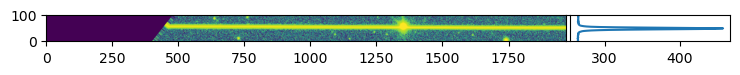

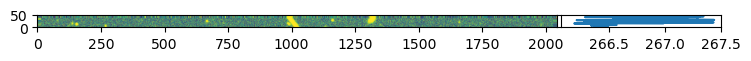

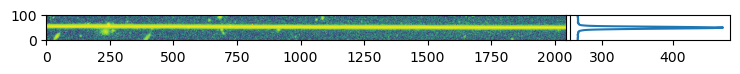

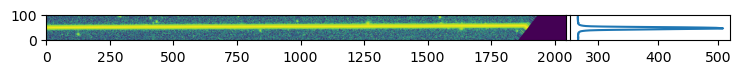

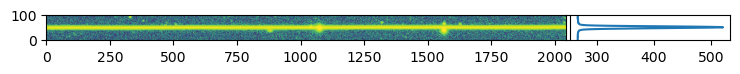

...

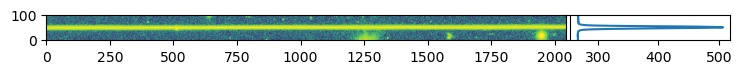

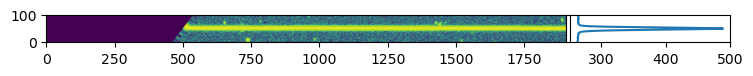

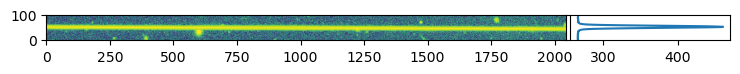

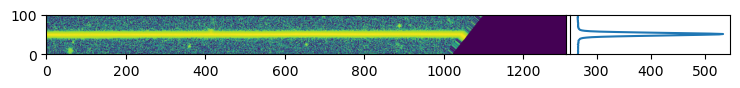

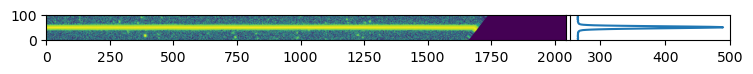

In [29]:
for det in [4,8,9,13,14, 15, 19, 20, 21, 22, 25, 26, 27, 29, 32, 33, 34, 35, 36, 37,39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 54]:
    call_photo(det)

In [27]:
hdulist[1].header

XTENSION= 'IMAGE   '           / Image extension                                
BITPIX  =                  -32 / Bits per pixel                                 
NAXIS   =                    2 / Number of axes                                 
NAXIS1  =                 2046 / Axis length                                    
NAXIS2  =                 4094 / Axis length                                    
PCOUNT  =                    0 / No 'random' parameters                         
GCOUNT  =                    1 / Only one group                                 
ORIGIN  = 'NOAO-IRAF FITS Image Kernel July 2003' / FITS file originator        
EXTNAME = 'S29     '           / Extension name                                 
DATE    = '2022-06-09T10:44:56' / Date FITS file was generated                  
IRAF-TLM= '2022-06-09T10:45:36' / Time of last modification                     
INHERIT =                    T / Inherits global header                         
WCSAXES =                   

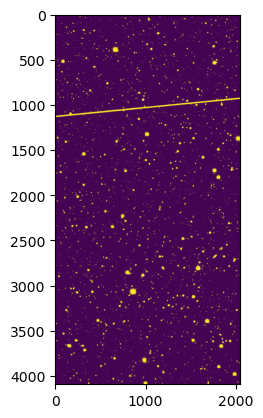

In [40]:
plt.imshow(detected_lines['Thresholded Image'])

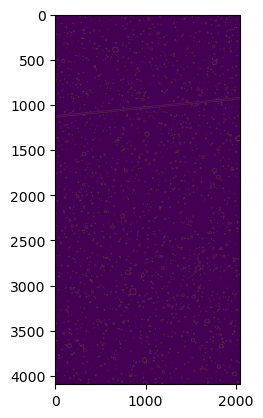

In [41]:
plt.imshow(detected_lines['Edges'])

In [42]:
clustered_lines

array([[1117.        ,    1.47480322,    0.        ],
       [1133.        ,    1.47480322,    0.        ]])

In [43]:
rotated_images

[]

In [44]:
print(detected_lines.keys())
for k, v in detected_lines.items():
    print(k, len(v))

dict_keys(['Lines', 'Angles', 'Cartesian Coordinates', 'Thresholded Image', 'Blurred Image', 'Edges'])
Lines 2
Angles 2
Cartesian Coordinates 2
Thresholded Image 4094
Blurred Image 4094
Edges 4094
